# 1. Zusammenfassung der Analyse

* 

In [224]:
# Importing libraries
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# 2. Loading the data

The scrapped data was in a 75MB json document containing almost 10K course details. 
The data has already been transformed and clearned. The transformation scripts generated two datasets:

* **courses_numerical_categorical_data.csv** contains non-textual fields for a typical exploratory data analysis.
* **courses_text_data.csv** contains only textual fields for NLP analysis.

As the dataset has already been cleaned and transformed there's no values missing. Some columns are the result of the processing steps, and a many fields from the original json have been removed.

In [225]:
import pandas as pd

pd.set_option('display.float_format', lambda x: '%.2f' % x)

data_folder_path = "../data/"
file_path = data_folder_path + "courses_numerical_categorical_data.csv"

# Read csv into a panda dataframe
df = pd.read_csv(file_path)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9969 entries, 0 to 9968
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   udemy_id                9969 non-null   int64  
 1   title                   9969 non-null   object 
 2   instructors             9969 non-null   object 
 3   locale                  9969 non-null   object 
 4   created                 9969 non-null   object 
 5   num_subscribers         9969 non-null   int64  
 6   rating                  9969 non-null   float64
 7   num_reviews             9969 non-null   int64  
 8   num_quizzes             9969 non-null   int64  
 9   num_lectures            9969 non-null   int64  
 10  num_curriculum_items    9969 non-null   int64  
 11  category                9969 non-null   object 
 12  subcategory             9969 non-null   object 
 13  labels                  9969 non-null   object 
 14  content_length_minutes  9969 non-null   

# 3. Understanding the target variable `num_subscribers`

Our target variable is the Number of subscribers `num_subscribers`.

### 3.1 General distribution of number of subscribers 

Immediately we'll see below there are natural outliers in the data. They are not noise or input errors, but highly successful courses, therefore we'll keep them. 

In [226]:
# Sort data frame by number od subscribers
df.sort_values(by='num_subscribers', ascending=False, inplace=True)

fig = make_subplots(rows=1, cols=2, shared_yaxes=True)


strip_plot = px.strip(df, y='num_subscribers', hover_data=df.columns)
violin_plot = px.violin(df, y='num_subscribers')

fig.add_trace(strip_plot['data'][0], row=1, col=1)
fig.add_trace(violin_plot['data'][0], row=1, col=2)

fig.update_layout(height=600, width=1024, title_text="Distribution of number of subscribers per course")
fig.show()


df['num_subscribers'].describe(percentiles=[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

count      9969.00
mean      15308.89
std       50499.90
min          44.00
10%         395.80
20%         729.60
30%        1278.40
40%        2150.20
50%        3515.00
60%        5782.60
70%        9723.80
80%       16097.00
90%       31173.80
max     1875450.00
Name: num_subscribers, dtype: float64

### 3.2 The feeling of success

As our goal is to understand how to break into the top courses, let's have a quick look at the top 10 courses to get a feel for it, and estimate their revenue. When looking at the courses below it's impressive to see that the top 10 courses are very lucrative, with 4 of them being about Python and Data Science.

In [227]:
df_top10 = df.head(10)[['subcategory', 'title', 'num_subscribers', 'num_reviews', 'rating', 'price']]
# Calculating potential revenue for each course
df_top10['Discounted revenue (in Millions)'] = round(df_top10['num_subscribers'] * df_top10['price'] * 0.2 * 0.0000001, 2) # Adding 80% discount because Udemy courses are always on sale. This is the minimum possible revenue I'd assume.

formatted_output = df_top10.head(10).to_string(index=False)

print(formatted_output)

          subcategory                                                        title  num_subscribers  num_reviews  rating  price  Discounted revenue (in Millions)
Programming Languages     The Complete Python Bootcamp From Zero to Hero in Python          1875450       498952    4.58 199.99                              7.50
      Web Development                   The Complete 2024 Web Development Bootcamp          1219060       365816    4.70 119.99                              2.93
Programming Languages           100 Days of Code: The Complete Python Pro Bootcamp          1213974       282675    4.68 109.99                              2.67
Programming Languages            Automate the Boring Stuff with Python Programming          1120833       112019    4.65 119.99                              2.69
         Data Science  Machine Learning A-Z: AI, Python & R + ChatGPT Prize [2024]          1037484       182664    4.53 139.99                              2.90
      Web Development       

### 3.2 The distribution of number of subscribers per quantile

Analysing the numer of subscribers in quantiles by removing the top 10% (by number of subscribers) we see that the median course has a lot less subscribers (2743,5) than the highly successful ones.

In [228]:
df.sort_values(by = 'num_subscribers', ascending = False, inplace = True) 
df_distribution = df

# Calculate the 90th percentile value for the column of interest
threshold = df_distribution['num_subscribers'].quantile(0.9)

# Filter the dataframe to get the top 10%
df_90_100_percentile = df_distribution[df_distribution['num_subscribers'] >= threshold]
df_90_percentile = df_distribution[df_distribution['num_subscribers'] < threshold]

fig = px.violin(df_90_percentile, y="num_subscribers", points="all", box=True, hover_data=df_90_percentile.columns)

fig.update_layout(title_text="Spread of Number of Subscribers excluding the top 10%")
fig.show()

If we cut the dataset by deciles, and ignored the last decile (top 10%) we get a better idea how the subscribers are aggregated in each group. We see the success gets increasingly concentrated in higher deciles.

In [229]:
# Calculate quartiles and add a new column to the dataframe
df_distribution['decile'] = pd.qcut(df['num_subscribers'], q=10, labels=['d1', 'd2', 'd3', 'd4', 'd5', 'd6', 'd7', 'd8', 'd9', 'd10'])

# Create a strip plot for the data in the first three quartiles
fig = px.box(df_distribution[~df_distribution['decile'].isin(['d10'])], x="num_subscribers", color="decile")

fig.update_layout(title_text="Distribution of Number of Subscribers by Decile excluding the last decile")
fig.show()

Another way to visualize this concetration is to calculate the total number of subscribers per decile plot it in a bar chart.

In [230]:
decile_sum = df_distribution.groupby('decile', observed=True)['num_subscribers'].sum()

fig = px.bar(x=decile_sum.index, y=decile_sum.values, labels={'x': 'Deciles', 'y': 'Total Num Subscribers'})
fig.update_layout(title_text="Total Number of Subscribers by Decile")
fig.show()

So now we have a clear picture how concentrated success is, let's understand what drives that success.

# 4. Why a course is successful?

Looking at the data we can outline a few hypothesis for investigation.

* Courses with more reviews will have more subscribers. There's a social proof effect 
* Courses with higher average rating will have more subscribers.
* Price category (Price bins) will influence the number of subscribers
* Time of publication will influence the number of subscribers (time to accummulate success)
* Length of curriculum & video lectures will drive up subscribers.
* Courses for beginners or intermediates will have more subscribers than for advanced.
* `num_reviews`, `num_quizzes`, `num_lectures`, `num_curriculum_items` are irrelevant for number of subscribers.
* Number of subscribers will be concentrated in just few subcategories (E.g. Data Science, Web Development, etc).
* Number of subscribers will be concentrated in just a few labels like `Python`.
* Number of subscribers will be concentrated in a few instructors (figured out the success formula, and cross-promotion)

### 4.1 Courses with more reviews will have more subscribers. There's a social proof effect.

Before we deep dive into each hypothesis, let's have a look at the correlation matrix with numerical fields to get an overview of these hypotheses and if there are any we are missing.


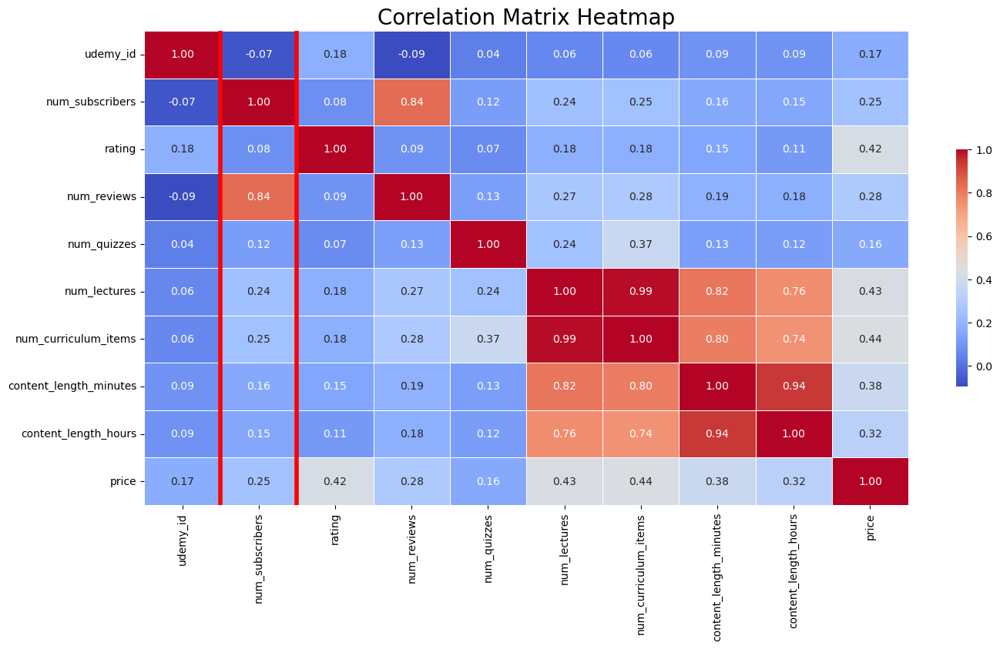

In [231]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate correlation matrix excluding non-numerical fields
corr_matrix = df.corr(numeric_only=True)

# Plot the heatmap
plt.figure(figsize=(16, 8)) 
sns.heatmap(corr_matrix, 
            annot=True, 
            cmap='coolwarm', 
            fmt=".2f", 
            xticklabels=corr_matrix.columns, 
            yticklabels=corr_matrix.columns,
            linewidths=.5, 
            cbar_kws={"shrink": .5})

plt.title('Correlation Matrix Heatmap', fontsize=20)
plt.xticks(rotation=90)  # Rotate the x-axis labels for better readability

# Highlighting the number of subscribers column
col_index = corr_matrix.columns.get_loc('num_subscribers')
plt.gca().axvline(col_index, color='red', linestyle='-', linewidth=4)  # Left border
plt.gca().axvline(col_index + 1, color='red', linestyle='-', linewidth=4)  # Right border

plt.show()

In [254]:
fig = px.scatter_matrix(df, dimensions=["num_subscribers", "rating", "num_reviews", "num_curriculum_items", "content_length_hours", "price"], color="decile")
# Update the layout to set the orientation of y-axis tick labels

fig.show()



The only strong positive correlation we can see from this heatmap is between the number of reviews and the number of subscribers. It's understandable as Udemy prompt students to review a course early on. 

Other weak positive correlations for the number of subscribers are the number of lectures/curriculum items. Maybe students judge a course quality by how comprehensive its curriculum is, and by the reviews. 

I'm curious if the correlation changes over different deciles (in this dataset about 1000 courses) showing how a given variable changes with number of subscribers. So we can look at the correlation matrix per decile.

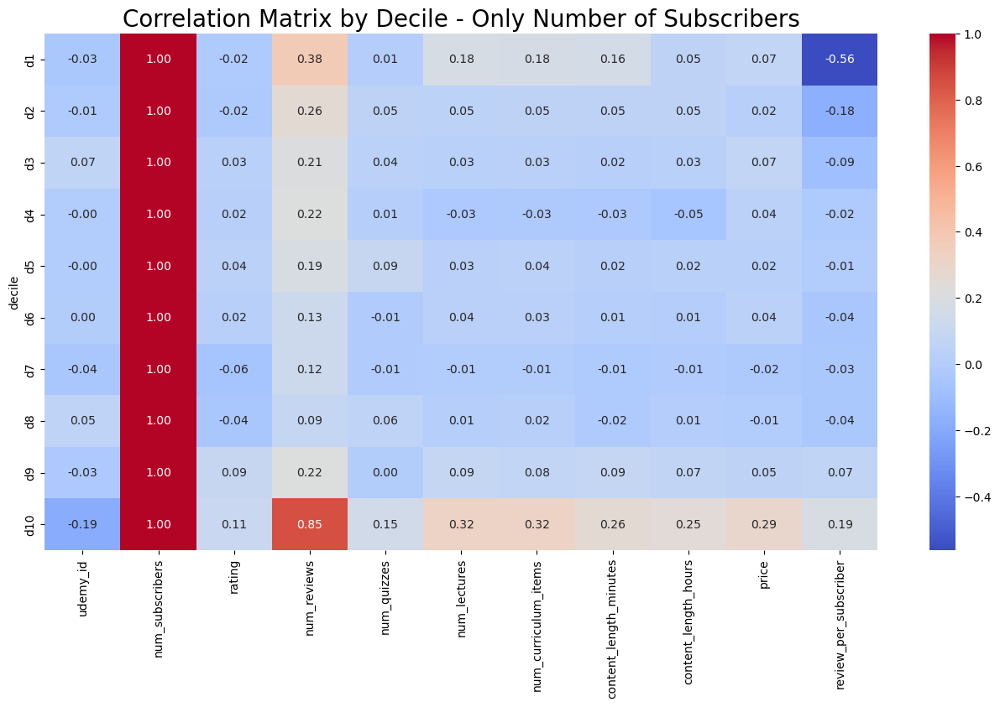

In [233]:
# Calculating the # subscribers per review to see if the ratio increases for courses with more subscribers.
df_distribution['review_per_subscriber'] = df_distribution['num_reviews'] / df_distribution['num_subscribers']

correlation_matrix_per_decile = df_distribution.groupby('decile', observed=True).corr(numeric_only=True)

plt.figure(figsize=(16, 8))
sns.heatmap(correlation_matrix_per_decile.xs('num_subscribers', level=1), 
            annot=True, 
            cmap='coolwarm', 
            fmt=".2f")
plt.title('Correlation Matrix by Decile - Only Number of Subscribers', fontsize=20)
plt.show()

The number of reviews is strongly correlated with the number of subscribers only in the last decile, where it explodes. At the same time, courses with more subscribers doesn't have more reviews per subscriber across deciles. Maybe there's a volume where a course hits enough reviews to have 'social proof' and attract more subscribers.

We also see that courses with more subscribers have higher number of lectures, longer content, and higher prices only in the most successful decile (still moderate correlation). 

While this is not causation, we could roughly say that, successful courses have more comprehensive curriculums, longer content, higher prices, and more reviews than other deciles, but similar ratio of reviews to subscribers to other deciles.

### 4.2 Courses with higher average rating will have more subscribers.

Let's look at the distribution of ratings first to see what 'bad' or good rating means at Udemy. We can see below that even at the average rating across quartiles are high.


In [234]:
df['rating'].describe()

count   9969.00
mean       4.25
std        0.44
min        1.44
25%        4.01
50%        4.34
75%        4.56
max        5.00
Name: rating, dtype: float64

To take a deeper look, let's check it per decile (ordered based on number of subscribers), and look at the mean, and median of the ratings per decile. Let's also normalize the ratings first to see better the changes. We see beloe that the rating does increase at each decile but the increase is small.

In [235]:
# Normalizing ratings
minimum = df['rating'].min()
maximum = df['rating'].max()
df['rating_normalized'] = (df['rating'] - minimum) / (maximum - minimum)
df['rating_normalized'] = df['rating_normalized'].round(2)

# Calculate mean and median rating
decile_mean_rating = df.groupby('decile', observed=True)['rating_normalized'].mean()
decile_median_rating = df.groupby('decile', observed=True)['rating_normalized'].median()

# Combine mean and median into a single dataframe
decile_central_tendency_rating = pd.concat([decile_mean_rating, decile_median_rating], axis=1)
decile_central_tendency_rating.columns = ['Mean Rating Normalized', 'Median Rating Normalized']
decile_central_tendency_rating

,Mean Rating Normalized,Median Rating Normalized
decile,,
d1,0.76,0.78
d2,0.76,0.78
d3,0.78,0.80
d4,0.79,0.81
d5,0.79,0.81
d6,0.80,0.82
d7,0.80,0.83
d8,0.80,0.82
d9,0.80,0.83


We can also visualize this relationship clearly below (for the 90th percentile). We see that lower ratings and higher ratings is present for courses with all number of subscribers. However, we see that for courses with less subscribers, there's more variance which is expected given they will have less reviews.

In conclusion, we can say the ratings play a minor role in the number of subscribers, as expected from the correlation matrix. 

However, without a causal experiment, it's hard to define consumers sensitivity to small variations in the rating. I'd hypothesied that consumers don't make their buying choice, consciously or unconciously, between two courses with a 0.2 difference in rating (E.g. 4.3 to 4.5). 

Maybe the insight is that, Udemy average ratings are high across the board for a good reason. They likely designed their experience so the prompt for rating happens at a very specific time (E.g. beginning of a course vs. end of a course, active consumers vs. passive consumers that did not start the course yet). The lesson outside platforms like Udemy is gathering the ratings at the right moment is essential to create the higher average ratings that drive trust & social proof. As se saw before that with the number of reviews (show of volume) could create a powerful social proof.

In [236]:
# Scatterplot of number of subscribers and rating

fig = px.scatter(df, x="num_subscribers", y="rating", trendline="ols", color="decile", hover_data=df.columns)
fig.update_layout(title_text="Number of Subscribers vs. Rating (Only 90th Percentile)")
fig.show()

### 4.3 Price category (Price bins) will influence the number of subscribers

We defined 5 price categories of equal width (usind the `pd.cut` function). Then each course will be assigned a price category. We see below that most courses are in the two lowest price categories. By also displaying the price categories we have a sense of the price ranges at Udemy, which could be helpful to help Cource creators price their product.

In [237]:
# Creating bins for each price category
df['price_category'] = pd.cut(df['price'], bins=5, labels=['$', '$$', '$$$', '$$$$', '$$$$$'])

# Calculate the min and max values for each label
min_max_values = df.groupby('price_category', observed=True)['price'].agg(['min', 'max', 'mean', 'median'])
print(min_max_values)

# Show number of courses in each price category
df['price_category'].value_counts()

                  min    max   mean  median
price_category                             
$               19.99  54.99  38.62   39.99
$$              59.99  89.99  72.49   69.99
$$$             94.99 124.99 103.69   99.99
$$$$           129.99 159.99 142.46  139.99
$$$$$          174.99 199.99 191.78  199.99


price_category
$        4978
$$       4100
$$$       759
$$$$       93
$$$$$      39
Name: count, dtype: int64

Lastly, we observe there's a trend of pricings being higher for courses with more subscribers. The most successful courses have higher price in general, but it's hard to say if the price has been adjust after they reached a certain number of subscribers. So looking at the snapshot price is flawed. Unfortunately, we don't have a pricing time series. As already discussed in the explanation of the dataset, Udemy is constantly running sales so the original prices are not reliable, however there's a tendency of the discounts being proportional to course original prices. 

Additionally, as soon as the discounted prices enter the consumer affordability range, then the absolute discount might influence drastically the decision, so courses priced higher originally might benefit a lot more from sales that Udemy constantly runs.

In [238]:
fig = px.scatter(df, x="num_subscribers", y="price", trendline="ols", color="decile", hover_data=df.columns)
fig.update_layout(title_text="Price vs Number of Subscribers")
fig.show()

My advice for course creators would be too price their course in the middle to upper range, and consider rasing price (only once of twice) after getting enough momentum (number of subscribers). Then they can time their price raise just before a major Udemy discount campaign. 

### 4.4 Time of publication will influence the number of subscribers (time to accummulate success)


First, let's have a look at the number of courses per year. It seems there's a reduction of courses in this categy ('development') since 2020, which is worrysome for Udemy, or is it a general trend in the market? That alone is surprising. 

In [239]:
# Prepare a new dataframe with created year and sorted by year
df_with_created_year = df.copy()
df_with_created_year['created_year'] = df_with_created_year['created'].apply(lambda date: pd.Timestamp(date).year)

# Sort by created date to create line plot
df_line_trace = df_with_created_year.sort_values(by='created', ascending=True) # Sort data frame by created date
df_line_trace.reset_index(drop=True, inplace=True) # Reset index

# Plot line with course 'index' over the time
line_trace = go.Scatter(
    x=df_line_trace['created'], 
    y=df_line_trace.index,
    name="Cumulative courses created"
)

# Counting the values per year
df_bar_trace = df_with_created_year['created_year'].value_counts().reset_index()

# Plotting the number of courses per year
bar_trace = go.Bar(
    y=df_bar_trace['count'], 
    x=df_bar_trace['created_year'],
    name="Courses created per year"
)

fig = go.Figure(data=[line_trace, bar_trace])

fig.update_xaxes(tickvals=df_with_created_year['created_year'], tickformat="%Y")
fig.update_layout(title_text="Courses over time")
fig.show()

Let's now look at the number of subscribers per year for each decile. To start let's remove the last decile. It seems for the vast majority of the courses the creation date will not hugely influence the number of subscribers. However, success will did not come overnight for the courses launched in the last few months.

In [240]:
df_with_created_year_90p = df_with_created_year[~df_with_created_year['decile'].isin(['d10'])] # Remove the last decile

# Plotting box chart
fig = px.box(
    df_with_created_year_90p, 
    x='created_year', 
    y='num_subscribers',
    hover_data=df_with_created_year_90p.columns
)

fig.update_xaxes(tickvals=df_with_created_year_90p['created_year'], tickformat="%Y")
fig.update_layout(title_text="Number of subscribers by year (90th Percentile)")

# Show the box plot
fig.show()

Looking at the top 10% most successful courses, we see they more often have been published 3+ year ago. Accumulating that many subscribers takes some time. For example the most successfull course, with 1.87M subscribers, was launched in 2015, so it also has to be kept up to date to be relevant in 2024.

In [241]:
df_with_created_year_d10 = df_with_created_year[df_with_created_year['decile'].isin(['d10'])] # Keep only last decile

# Assuming df is your DataFrame
fig = px.box(
    df_with_created_year_d10, 
    x='created_year', 
    y='num_subscribers',
    hover_data=df_with_created_year_d10.columns
)

fig.update_xaxes(tickvals=df_with_created_year_90p['created_year'], tickformat="%Y")
fig.update_layout(
    title_text="Number of subscribers by year (Last decile) - Autofocused below 300k subscribers",
    yaxis=dict(range=[20000, 300000])  # Set the initial y-axis range from 0 to 10
)

# Show the box plot
fig.show()

My recommendation for course creator here is to be paitient. There are fewer courses in the top 10% that were created in 2022-2023 when compared to 2019-2021.  

### 4.5 Length of curriculum & video lectures will drive up subscribers.

We have seen a moderate correlation between curriculum `num_curriculum_items` and `num_subscribers` in the last decile. 

Similarly with `content_length_hours`. Let's look at it more closely.

First let's see numbers of subscribers per number of curriculum items. As you can see for the first 9 deciles there's not a big impact of the number of curriculum items on the number of subscribers.

In [242]:
fig_d1_to_d9 = px.scatter(
    df[~df['decile'].isin(['d10'])], 
    x="num_curriculum_items", 
    y="num_subscribers", 
    trendline="ols", 
    color="decile", 
    hover_data=df.columns
)

fig_d1_to_d9.update_layout(
    height=600, width=1024,
    title_text="# Subscribers vs # Curriculum Items (decilles 1 to 9)"
)

fig_d1_to_d9.show()

But when you look at the 10% most successful courses, it's clear that the number of curriculum items grows with the number of subscribers. A recommendation for course creators would then to create an extensive curriculum with many items. Maybe consumers can judge the content of a course better when there's a lot more of curriculum items outlined as they can't audit all of them before taking the course. Also more curriculum items might give a sense that a course is more comprehensive, reducing fear of missing out on important content.

In [243]:
fig_d10 = px.scatter(
    df[df['decile'].isin(['d10'])], 
    x="num_curriculum_items", 
    y="num_subscribers", 
    trendline="ols", 
    color="decile", 
    hover_data=df.columns
)

fig_d10.update_layout(
    height=600, width=1024,
    title_text="# Subscribers vs # Curriculum Items (decile 10)",
    yaxis=dict(range=[0, 500000])  # Set the initial y-axis range to make the visual less affected by outliers
)

fig_d10.show()

Let's do the same now with the length of the course (hours of video). No surprises in the picture below given the very strong positive correlation between content length and number of curriculum items (more curriculum items = more video lectures).

In [244]:
fig_scatter_content_length = px.scatter(
    df, 
    x="content_length_hours", 
    y="num_subscribers", 
    trendline="ols", 
    color="decile", 
    hover_data=df.columns
)

fig_scatter_content_length.update_layout(
    height=600, width=1024,
    title_text="Number of Subscribers vs Content length (All deciles)",
    yaxis=dict(range=[0, 500000])  # Set the initial y-axis range to make the visual less affected by outliers
)

fig_scatter_content_length.show()

My recommendation to a course creator is to ensure her course has a comprehrensive curriculum, and enough content to match it. That said you can find successful courses with more or less curriculums and content length.

### 4.6 Courses for beginners or intermediates will have more subscribers than for experts.

We can quickly see below that courses aimed at All Levels, Beginner Level, Intermediate Level, Expert Level, have in this order lower number of cumulative subscribers across all deciles. It makes generally sense the higher levels reduce adressable market size. This is also a reflection of the audience of Udemy, it's probably not attracting consumers with some degree of experience in the topic they want to learn. Maybe the best advice for course creators in this situation would be to market their course in platforms better targeted for their audience.

In [245]:
fig = px.histogram(
    df, 
    x='instructional_level', 
    y='num_subscribers', 
    hover_data=df.columns, 
    color='decile',
    barmode="group",
    title="Distribution of Number of Subscribers by Instructional Level",
    labels={'instructional_level': 'Instructional Level', 'num_subscribers': 'Number of Subscribers'}
)

fig.show()

### 4.7 Number of subscribers will be concentrated in just few subcategories (E.g. Data Science, Web Development, etc).

### 4.8 Number of subscribers will be concentrated in just a few labels like `Python`.

In [246]:
from ast import literal_eval
df_exploded_labels = df.copy()
df_exploded_labels['labels'] = df_exploded_labels['labels'].apply(literal_eval)
df_exploded_labels = df_exploded_labels.explode('labels')
df_exploded_labels['labels'] = df_exploded_labels['labels'].fillna('No Labels')
df_exploded_labels.sort_values(by='labels', ascending=True, inplace=True)

A quick look at the data, shows how many labels and how often they appear. There are 1343 labels in total. Python appear most often, followerd by Javascript.

In [247]:
df_exploded_labels['labels'].value_counts()

labels
Python                        994
JavaScript                    603
Web Development               516
No Labels                     468
Java                          448
                             ... 
AWS Elastic Load Balancing      1
Futures Trading                 1
GDPR                            1
GIMP                            1
zBrush                          1
Name: count, Length: 1343, dtype: int64

Let's visualize the labels frequency in a histogram for the top 

In [248]:
label_stats_summary = df_exploded_labels.groupby('labels')['num_subscribers'].agg(['min', 'max', 'mean', 'median', 'sum', 'count']).reset_index()

top100_by_course_count = label_stats_summary.sort_values(by='count', ascending=False).head(100)
fig = px.histogram(
    top100_by_course_count, 
    hover_data=top100_by_course_count.columns,	
    x="labels", 
    y="count",
    title="Top 100 Labels by number of courses",
    labels={'labels': 'Label name', 'count': 'Courses'}
)

fig.update_xaxes(tickvals=top100_by_course_count['labels'], tickfont=dict(size=10))

fig.show()

Now we look at how many subscribers each label has (sum of subscribers in a course with this label). We see that in fact a few labels like Python and Javascript accumulated a lot of subscribers compared to others labels.

In [249]:
top100_by_sum_subscribers = label_stats_summary.sort_values(by='sum', ascending=False).head(100)


fig = px.histogram(
    top100_by_sum_subscribers, 
    hover_data=top100_by_sum_subscribers.columns,	
    x="labels", 
    y="sum",
    title="Top 100 Labels with most subscribers",
    labels={'labels': 'Label name', 'count': 'Courses'}
)

fig.update_xaxes(tickvals=top100_by_sum_subscribers['labels'], tickfont=dict(size=10))

fig.show()

To make this point of view objective, let's cut the labels in deciles and see how concentrated is the success. From the histogram we can see that the last decile (top 10%) concetrates most of the subscribers.

In [250]:
label_stats_summary.sort_values(by='sum', ascending=False, inplace=True)
label_stats_summary['decile'] = pd.qcut(label_stats_summary['sum'], 10, labels=['d1', 'd2', 'd3', 'd4', 'd5', 'd6', 'd7', 'd8', 'd9', 'd10']) # Adding deciles

fig_scatter_labels = px.scatter(
    label_stats_summary, 
    y="decile", 
    x="sum", 
    color="decile", 
    hover_data=label_stats_summary.columns
)

fig_scatter_labels.add_annotation(
    text="<sup>Opened with Zoom below 800k subscribers. Use autoscale to view all data. </sup> ",
    xref="paper", yref="paper",
    x=1, y=1.05,
    showarrow=False,
)

fig_scatter_labels.update_layout(
    height=600, width=1024,
    title_text="Total Number of Subscribers per Label (All deciles)",
    xaxis=dict(range=[0, 800000])  # Set the initial y-axis range to make the visual less affected by outliers
)

fig_scatter_labels.show()


Lastly, if we focus only on the top 20 labels (by number of subscribers), we see that for each label there are courses with different number of subscribers. So choosing a success topic won't guarantee the success for a course creator.

In [251]:
# Get top 20 labels by number of subscribers
top20_labels = label_stats_summary.sort_values(by='sum', ascending=False).head(20)

# Filter all courses with these labels
courses_with_top20_label = df_exploded_labels[df_exploded_labels['labels'].isin(top20_labels.labels)]

fig_top20_labels = px.box(
    courses_with_top20_label, 
    hover_data=courses_with_top20_label.columns,	
    x="labels", 
    y="num_subscribers",
    title="Top 20 labels spread of number of subscribers",
    labels={'labels': 'Label name', 'num_subscribers': 'Number of Subscribers'}
)

fig_top20_labels.add_annotation(
    text="<sup>Opened with Zoom below 50k subscribers. Use autoscale to view all data. </sup> ",
    xref="paper", yref="paper",
    x=1, y=1.05,
    showarrow=False,
)

fig_top20_labels.update_layout(
    height=600, width=1024,
    yaxis=dict(range=[0, 50000]),  # Set the initial y-axis range to make the visual less affected by outliers
)

fig_top20_labels.show()

### 4.9 Number of subscribers will be concentrated in a few instructors (figured out the success formula, and cross-promotion)